load packages

In [1]:
using JuMIT
using Statistics
using Plots
pyplot()

Plots.PyPlotBackend()

create simple (almost) homogeneous acoustic model

In [2]:
model=J.Gallery.Seismic(:acou_homo1)
J.Models.Seismic_addon!(model, randn_perc=0.01)

JuMIT.Models.Seismic([1500.0, 3500.0], [1.0, 1.0], [1500.0, 3500.0], [5.93203e-6 0.000118116 … -1.68226e-5 9.01935e-6; -7.38811e-5 8.76849e-5 … 5.71476e-5 4.33821e-5; … ; -0.000106719 4.2779e-6 … -1.26287e-5 -6.35962e-5; -3.85469e-5 -4.30732e-5 … -8.33599e-6 0.000140992], [-2.91035e-6 -5.13991e-5 … -0.000120847 -0.000104828; 2.78767e-5 5.07488e-5 … -9.62508e-5 -3.20544e-5; … ; -9.14068e-5 -0.000181437 … 5.6237e-5 -6.02651e-5; -1.27018e-5 -3.54734e-5 … -3.99771e-5 2.30641e-5], [-0.0001549 -0.000195476 … -6.7766e-5 2.42267e-7; 1.42263e-5 -9.5e-5 … 0.000176232 -3.75149e-5; … ; 3.15602e-5 -1.74817e-6 … -0.00013581 -3.69323e-6; 2.61909e-5 0.000114682 … -1.34554e-5 7.53939e-5], StepRangeLen{Float64,Base.TwicePrecision{Float64},Base.TwicePrecision{Float64}}[-1000.0:10.0:1000.0, -1000.0:10.0:1000.0], [3.375e9, 4.2875e10], [1500.0, 3500.0], [2.33236e-11, 2.96296e-10], [0.000285714, 0.000666667], [0.000285714, 0.000666667], JuMIT.Models.Seismic_ref{Float64}(2500.0, 1.0, 2500.0, 2.3125e10, 2500.0

a simple acquisition geometry

In [3]:
acqgeom = JuMIT.Gallery.Geom(model.mgrid,:xwell);

	Acquisition Geometry:	xwell
	> number of supersources:	2
	> sources per supersource:	min	1	max	1
	> receivers per supersource:	min	2	max	2
	> number of unique positions of:	sources	2	receivers	2


plot the model and source, receivers

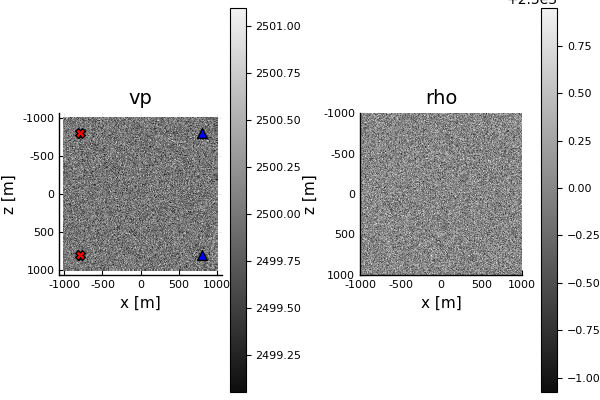

In [4]:
p1=JP.seismic(model)
JP.geom!(acqgeom)
plot(p1)

generate time grid

In [5]:
tgrid = range(0.0,stop=2.0,length=1000)

0.0:0.002002002002002002:2.0

Ricker wavelet

In [6]:
wav = JuMIT.Utils.Wavelets.ricker(10.0, tgrid, tpeak=0.25,);

distribute the same source wavelet to all the supsersources

In [7]:
acqsrc=JuMIT.Acquisition.Src_fixed(acqgeom.nss,1,[:P],wav,tgrid);

create `Fdtd.Param` object to prepare forward modelling
* npw corresponds to the number of independently propagating wavefields (1 in most cases)

In [8]:
pa=JuMIT.Fdtd.Param(npw=1,model=model,
	acqgeom=[acqgeom], acqsrc=[acqsrc],
	sflags=[2], rflags=[1],
	tgridmod=tgrid, verbose=true);

┌ Info: spatial sampling (1.00e+01) can be as high as 1.02e+01
└ @ JuMIT.Fdtd /math/home/pawbz/.julia/dev/JuMIT/src/Fdtd/Fdtd.jl:1001
┌ Warning: decrease time sampling (2.00e-03) below 1.43e-03
└ @ JuMIT.Fdtd /math/home/pawbz/.julia/dev/JuMIT/src/Fdtd/Fdtd.jl:1012


Once the `Param` object is created, do the modelling "without any memory allocations" using `mod!`

In [9]:
@time JuMIT.Fdtd.mod!(pa);

	modeling supershot 1/2 100%|███████████████████████████| Time: 0:00:02
	modeling supershot 2/2 100%|███████████████████████████| Time: 0:00:02
 ──────────────────────────────────────────────────────────────────────────
                                   Time                   Allocations      
                           ──────────────────────   ───────────────────────
     Tot / % measured:          4.63s / 100%             233KiB / 98.2%    

 Section           ncalls     time   %tot     avg     alloc   %tot      avg
 ──────────────────────────────────────────────────────────────────────────
 mod_per_proc!          1    4.63s   100%   4.63s    182KiB  79.5%   182KiB
 initialize!            1   2.52ms  0.05%  2.52ms   36.8KiB  16.1%  36.8KiB
 record data            1   80.3μs  0.00%  80.3μs   8.19KiB  3.58%  8.19KiB
 stack_grads!           1   44.1μs  0.00%  44.1μs   2.05KiB  0.89%  2.05KiB
 update gradient        1    242ns  0.00%   242ns         -  0.00%        -
 ──────────────────

plot a record after modelling

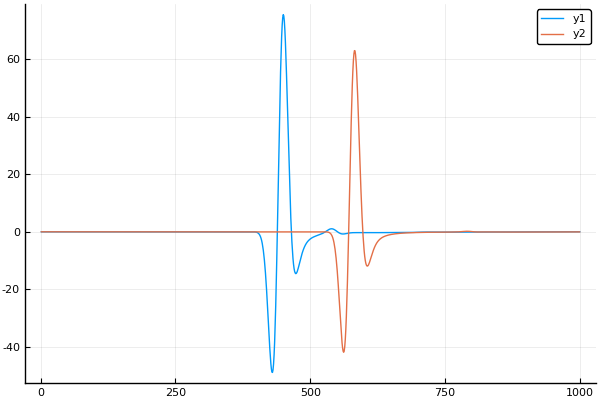

In [10]:
pdata=plot(pa.c.data[1].d[1,1])
plot(pdata)

create new seismic model

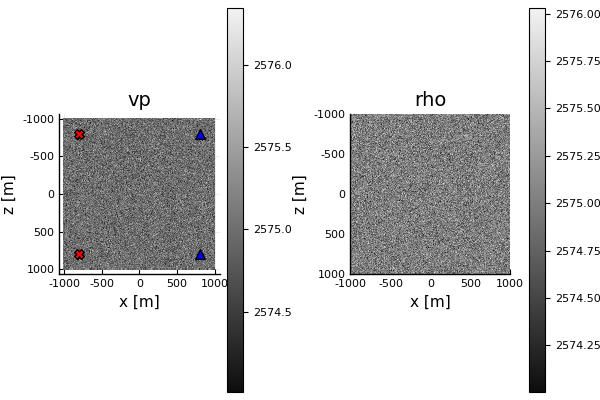

In [11]:
model_new=J.Gallery.Seismic(:acou_homo1) # prepare another model
J.Models.Seismic_addon!(model_new, randn_perc=0.01)
J.Models.Seismic_addon!(model_new, constant_pert=0.03) # perturb the model
p2=JP.seismic(model_new) # plot new model
JP.geom!(acqgeom)
plot(p2)

Now, we the change the model in the `Param` object without memory allocation
This routine can be used during FWI,
where medium parameters are itertively updated in the same `Fdtd.Param` object

In [12]:
J.Fdtd.update_model!(pa.c, model_new)

run modelling now and plot data again

In [13]:
@time JuMIT.Fdtd.mod!(pa);

	modeling supershot 1/2 100%|███████████████████████████| Time: 0:00:02
	modeling supershot 2/2 100%|███████████████████████████| Time: 0:00:02
 ──────────────────────────────────────────────────────────────────────────
                                   Time                   Allocations      
                           ──────────────────────   ───────────────────────
     Tot / % measured:          4.64s / 100%             242KiB / 98.2%    

 Section           ncalls     time   %tot     avg     alloc   %tot      avg
 ──────────────────────────────────────────────────────────────────────────
 mod_per_proc!          1    4.63s   100%   4.63s    188KiB  79.2%   188KiB
 initialize!            1   4.71ms  0.10%  4.71ms   39.1KiB  16.5%  39.1KiB
 record data            1   77.6μs  0.00%  77.6μs   8.25KiB  3.47%  8.25KiB
 stack_grads!           1   41.9μs  0.00%  41.9μs   2.11KiB  0.89%  2.11KiB
 update gradient        1    270ns  0.00%   270ns         -  0.00%        -
 ──────────────────

plot a record after modelling

In [14]:
plot!(pdata, pa.c.data[1].d[1,1])
plot(pdata);

*This notebook was generated using [Literate.jl](https://github.com/fredrikekre/Literate.jl).*